In [2]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
from matplotlib import gridspec
import pandas as pd

In [3]:
folderPath = "/home/karn/Downloads/"
subject_joint_angle = pd.read_csv(folderPath+'subject1_OAIC_S38_4-JointAngles.csv',
        header=0,
        usecols=[".data"])
# print(subject_joint_angle.head())
# print(subject_joint_angle.values)
subject_numpy_str = subject_joint_angle.to_numpy()
subject_numpy_num = []
for s in subject_numpy_str:
    temp = s[0].strip("()").split(",")
    list_float = [float(x) for x in temp]
    subject_numpy_num.append(list_float)
print(subject_numpy_num)
# subject_numpy_int = tuple(float(s[0].strip("()").split(",")) for s in subject_numpy_str)
# print(subject_numpy_int)

[[-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6.0, -2.0, 2.0, 6.0], [-1.0, 0.0, 6

In [4]:
class plastic:
    
    def __init__(self, o0, o1, o2, initial_phi, _alpha, lrate):
        self.out0_t = o0
        self.out1_t = o1
        self.out2_t = o2
        self.phi =  initial_phi
        self.alpha = _alpha
        self.w20_t = 0  # w -> weight
        self.w02_t = 1 # Default = 1
        self.w2p_t = 0.03
        self.learning = lrate # default = 1.3
        self.counter = 0
        
        # Default -----------
#         self.A02 = 1
#         self.A20 = 1
#         self.A2p = 1
#         self.B02 = 0.01
#         self.B20 = 0.01
#         self.B2p = 0.01
#         factor = 0.0001
        factor = 1
        self.A02 = 1*factor
        self.A20 = 1*factor
        self.A2p = 1
        self.B02 = 0.01*factor
        self.B20 = 0.01*factor
        self.B2p = 0.01*factor
        
        self.z = 0
        self.beta = 0.5
        
        self.w00 = self.alpha*np.cos(self.phi)
        self.w01 = self.alpha*np.sin(self.phi)
        self.w10 = self.alpha*(-np.sin(self.phi))
        self.w11 = self.alpha*np.cos(self.phi)

        
    def getAll(self):
        print("out0_t: {}".format(self.out0_t))
        print("out1_t: {}".format(self.out1_t))
        print("out2_t: {}".format(self.out2_t))
        print("freq: {}".format(self.phi/(2*3.14)))
        print("alpha: {}".format(self.alpha))
        print("w20_t: {}".format(self.w20_t))
        print("w02_t: {}".format(self.w02_t))
        print("w2p_t: {}".format(self.w2p_t))
        print("learning: {}".format(self.learning))
        print("A02: {}".format(self.A02))
        print("A20: {}".format(self.A20))
        print("A2p: {}".format(self.A2p))
        print("B02: {}".format(self.B02))
        print("B20: {}".format(self.B20))
        print("B2p: {}".format(self.B2p))
    
    def updateWeights(self):
        # + SGD ----------------- stocastic gradient descent (new = old + (lrate*error))
        e = 1
        self.phi = self.phi + self.learning*self.w02_t*self.out2_t*self.w01*self.out1_t*e
        # - SGD -----------------

#         # + Momentum -----------------
#         e = -1
#         self.z = self.beta*self.z + self.w02_t*self.out2_t*self.w01*self.out1_t
#         self.phi = self.phi - self.learning*self.z*e
#         # - Momentum -----------------
        # update phi
        self.w00 = self.alpha*np.cos(self.phi)
        self.w01 = self.alpha*np.sin(self.phi) 
        self.w10 = self.alpha*(-np.sin(self.phi)) 
        self.w11 = self.alpha*np.cos(self.phi)  
    
    def getOut0(self):
        return self.out0_t
    
    def getOut1(self):
        return self.out1_t
    
    def getOut2(self):
        return self.out2_t
    
    def setPhi(self, newPhi):
        self.phi = newPhi
        
    def getFrequency(self):
        if (self.alpha != 1.01):
            return -1
        else:
            return self.phi/(2*3.14)
    
    def getW2p(self):
        return self.w2p_t
    
    def getW20(self):
        return self.w20_t
    
    def getW02(self):
        return self.w02_t
    
    def getW00(self):
        return self.w00
    
    def getW01(self):
        return self.w01
    
    def getW10(self):
        return self.w10
    
    def getW11(self):
        return self.w11
    
    def update(self, perturbation):
        w20_init = 0
        w02_init = 1
        w2p_init = 0.03

            
        self.out0_t1 = np.tanh(self.w00*self.out0_t + self.w01*self.out1_t + self.w02_t*self.out2_t)
        self.out1_t1 = np.tanh(self.w10*self.out0_t + self.w11*self.out1_t)
        self.out2_t1 = np.tanh(self.w20_t*self.out0_t + self.w2p_t*(perturbation))

        self.updateWeights()

        self.w20_t1 = self.w20_t - self.A20*self.out2_t*self.out0_t - self.B20*(self.w20_t - w20_init)
        self.w02_t1 = self.w02_t - self.A02*self.out0_t*self.out2_t - self.B02*(self.w02_t - w02_init)
        self.w2p_t1 = self.w2p_t + self.A2p*self.out2_t*perturbation - self.B2p*(self.w2p_t - w2p_init)

        self.out0_t = self.out0_t1
        self.out1_t = self.out1_t1
        self.out2_t = self.out2_t1

        self.w20_t = self.w20_t1
        self.w02_t = self.w02_t1
        self.w2p_t = self.w2p_t1

No external perturbation

In [62]:
# phi = 2*pi*cpgFreq
# cpgFreq *No unit need to find the conversion factor to Hz which is x10
# Ex. cpgFreq = 0.07 x 10-> 0.7 Hz x timeStep -> cycle/step

maxTime = 1000
timeStep = 0.01 # working = 0.1 s/step
maxStep = int(maxTime/timeStep)
time = np.arange(0, maxTime, timeStep)
step = np.arange(0, maxStep, 1)

cpgInitialFrequency = 0.01
learnRate = 1.3 # Default = 1.3
alpha = 1.01
out0 = 0.2
out1 = 0.2
out2 = 0.2
cpg = plastic(out0, out1, out2, cpgInitialFrequency*2*3.14, alpha, learnRate)
cpg.getAll()

y = np.zeros((1, maxStep))

sizeOut = time.shape[0]
out0 = np.empty((1,sizeOut))
out1 = np.empty((1,sizeOut))
out2 = np.empty((1,sizeOut))
outFreq = np.empty((1,sizeOut))
w2p = np.empty((1,sizeOut))
w02 = np.empty((1,sizeOut))
w20 = np.empty((1,sizeOut))
w00 = np.empty((1,sizeOut))
w01 = np.empty((1,sizeOut))
w10 = np.empty((1,sizeOut))
w11 = np.empty((1,sizeOut))
per = np.empty((1,sizeOut))

for idx, val in enumerate(time):
    if (val >= 10 and val < 20):
#         cpg.update(0.01)
        cpg.update(0.0)
        per[0][idx] = 0.0
    elif (val >= 20 and val < 100):
        cpg.update(0.0)
        per[0][idx] = 0.0
    elif (val >= 100):
        cpg.update(0.0)
        per[0][idx] = 0.0
    else:
        cpg.update(0.0)
        per[0][idx] = 0.0
#     print("----idx: {}".format(idx))
#     cpg.getAll()
    out0[0][idx] = cpg.getOut0()
    out1[0][idx] = cpg.getOut1()
    out2[0][idx] = cpg.getOut2()
    outFreq[0][idx] = cpg.getFrequency()
    w2p[0][idx] = cpg.getW2p()
    w02[0][idx] = cpg.getW02()
    w20[0][idx] = cpg.getW20()
    w00[0][idx] = cpg.getW00()
    w01[0][idx] = cpg.getW01()
    w10[0][idx] = cpg.getW10()
    w11[0][idx] = cpg.getW11()


out0_t: 0.2
out1_t: 0.2
out2_t: 0.2
freq: 0.01
alpha: 1.01
w20_t: 0
w02_t: 1
w2p_t: 0.03
learning: 1.3
A02: 1
A20: 1
A2p: 1
B02: 0.01
B20: 0.01
B2p: 0.01


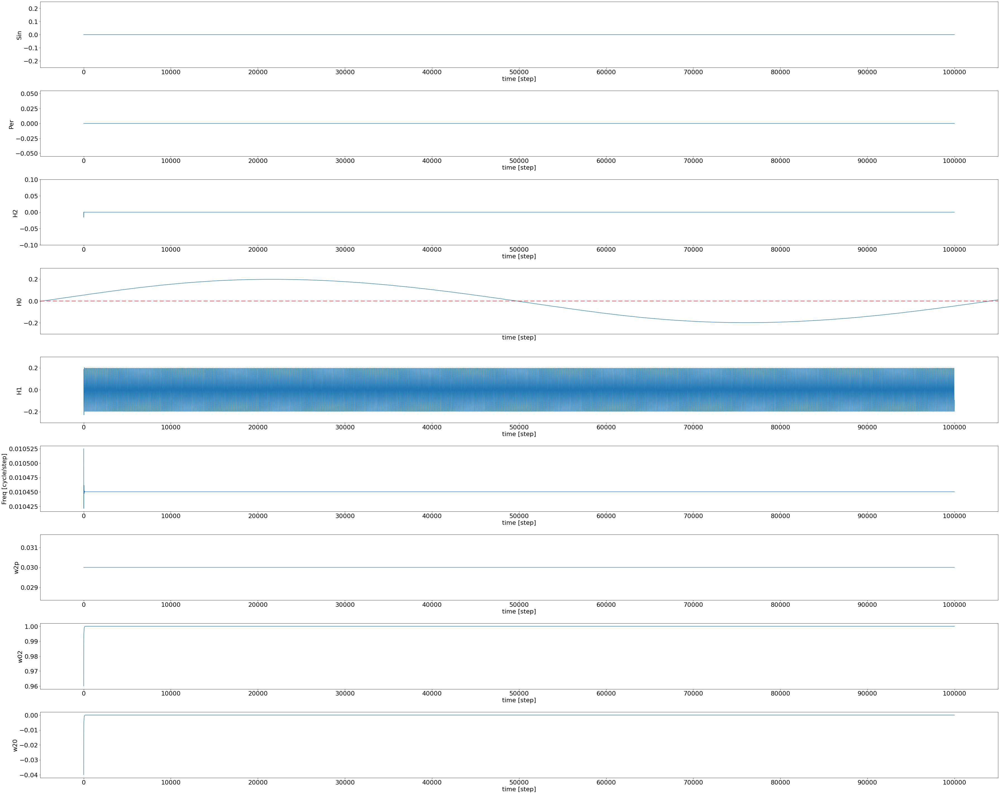

In [78]:
plt.rcParams.update({'font.size': 22})

f = plt.figure(figsize=(50,40))
ax1 = f.add_subplot(911)
ax2 = f.add_subplot(912)
ax3 = f.add_subplot(913)
ax4 = f.add_subplot(914)
ax5 = f.add_subplot(915)
ax6 = f.add_subplot(916)
ax7 = f.add_subplot(917) # w2p
ax8 = f.add_subplot(918) # w02
ax9 = f.add_subplot(919) # w20

ax1.plot(step, y[0])
ax1.set_xlabel('time [step]')
ax1.set_ylabel('Sin')
ax1.set(ylim = (-0.25, 0.25))
ax1.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax2.plot(step, per[0])
ax2.set_xlabel('time [step]')
ax2.set_ylabel('Per')
# ax2.set(ylim = (-0.1, 0.1))
ax2.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax3.plot(step, out2[0])
ax3.set_xlabel('time [step]')
ax3.set_ylabel('H2')
ax3.set(ylim = (-0.1, 0.1))
ax3.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax4.plot(step, out0[0])
ax4.set_xlabel('time [step]')
ax4.set_ylabel('H0')
ax4.set(ylim = (-0.3, 0.3))
ax4.set_xticks(np.arange(0, maxStep + 1, maxStep/10))
ax4.axhline(y = 0, linestyle=(0, (10, 5)), color = 'r')
strt = 1710
endd = 1807
ax4.set(xlim = (strt, endd))

ax5.plot(step, out1[0])
ax5.set_xlabel('time [step]')
ax5.set_ylabel('H1')
ax5.set(ylim = (-0.3, 0.3))
ax5.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax6.plot(step, outFreq[0]) # 10 is conversion factor from cpgFreq to Hz
ax6.set_xlabel('time [step]')
ax6.set_ylabel('Freq [cycle/step]')
# ax6.set(ylim = (min(outFreq[0]), max(outFreq[0])))
# ax6.set_yticks(np.arange(0, 1.1, 0.1))
ax6.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax7.plot(step, w2p[0])
ax7.set_xlabel('time [step]')
ax7.set_ylabel('w2p')
# ax7.set_yticks(np.arange(0, 1.1, 0.1))
ax7.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax8.plot(step, w02[0])
ax8.set_xlabel('time [step]')
ax8.set_ylabel('w02')
# ax8.set_yticks(np.arange(0, 1.1, 0.1))
ax8.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax9.plot(step, w20[0])
ax9.set_xlabel('time [step]')
ax9.set_ylabel('w20')
# ax9.set_yticks(np.arange(0, 1.1, 0.1))
ax9.set_xticks(np.arange(0, maxStep + 1, maxStep/10))


plt.tight_layout()
plt.show()
# picCPGSim = 'CPGSim.eps'
# f.savefig(picCPGSim, dpi = 300)

In [19]:
out0[0][150:200]

array([-0.00449602, -0.13052729, -0.19739874, -0.1767513 , -0.07747465,
        0.05716911,  0.16569156,  0.19982616,  0.14561472,  0.02602389,
       -0.1055992 , -0.18916431, -0.18855039, -0.10435953,  0.02719511,
        0.14637816,  0.19949607,  0.16432512,  0.05577944, -0.07835574,
       -0.17674152, -0.19610588, -0.12872321, -0.00327391,  0.12380246,
        0.19473417,  0.17925921,  0.08410835, -0.04939853, -0.16037218,
       -0.19926859, -0.15004957, -0.03354596,  0.09844641,  0.18562703,
        0.19011776,  0.11038314, -0.01938361, -0.1403898 , -0.19797262,
       -0.16789279, -0.06293036,  0.07087056,  0.17235066,  0.19668345,
        0.1340284 ,  0.01099812, -0.11721822, -0.19223809, -0.18188493])

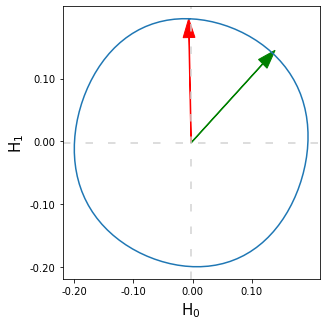

In [156]:
f, ax = plt.subplots(1, 1, figsize=(5,5))

markers_on = [0, time.shape[0]-1][strt:endd]

ax.plot(out0[0][strt:endd], out1[0][strt:endd])
ax.plot(out0[0][strt:endd], out1[0][strt:endd], 'xr', markevery = markers_on)
iList2 = 0
coords2 = list(zip(out0[0][strt:endd], out1[0][strt:endd]))
dList2 = [coords2[0], coords2[len(coords2)-1]]
# for d in dList2:
#     ax.annotate('%s' %iList2, xy = d, textcoords = 'data', size = 16, color = 'r')
#     iList2 = iList2 + len(coords2)
ax.arrow(0, 0, out0[0][strt:endd][0], out1[0][strt:endd][0]-0.03, head_width = 0.02, fc = 'r', ec = 'r')
ax.arrow(0, 0, out0[0][strt:endd][10], out1[0][strt:endd][10]-0.03, head_width = 0.02, fc = 'g', ec = 'g')
ax.axvline(x = 0.0, color = 'lightgrey', linestyle = (0, (5, 10)))
ax.axhline(y = 0.0, color = 'lightgrey', linestyle = (0, (5, 10)))
ax.set_xlabel(r'$\mathrm{H_0}$')
ax.set_ylabel(r'$\mathrm{H_1}$')

xticks = np.arange(min(out0[0][strt:endd]), max(out0[0][strt:endd]), 0.1)
yticks = np.arange(min(out1[0][strt:endd]), max(out1[0][strt:endd]), 0.1)
ax.set_xticks(xticks)
ax.set_yticks(yticks)
ax.set_xticklabels(labels = ['{0:0.2f}'.format(x) for x in xticks], fontsize = 10)
ax.set_yticklabels(labels = ['{0:0.2f}'.format(x) for x in yticks], fontsize = 10)

plt.tight_layout()
plt.show()

pic = 'LimitCycle.png'
# f.savefig(folderPath + '/Pic/' + pic, dpi = 150, facecolor = "white", bbox_inches = "tight")

In [111]:
lmc_phi = np.arctan2(out0[0][strt:endd], out1[0][strt:endd])
lmc_phi

array([-0.01818258,  0.04807099,  0.11514597,  0.18294032,  0.25129885,
        0.32002337,  0.38888707,  0.45765195,  0.52608739,  0.59398816,
        0.66118978,  0.72757987,  0.79310484,  0.85777154,  0.92164459,
        0.98483993,  1.04751582,  1.1098618 ,  1.17208675,  1.23440633,
        1.29703034,  1.36015036,  1.42392793,  1.48848392,  1.55388951,
        1.6201596 ,  1.68724967,  1.75505659,  1.82342422,  1.89215365,
        1.96101771,  2.02977834,  2.09820526,  2.16609389,  2.23328066,
        2.29965431,  2.36516239,  2.42981292,  2.49367157,  2.55685523,
        2.61952284,  2.68186444,  2.74408918,  2.80641271,  2.86904459,
        2.93217592,  2.99596758,  3.06053954,  3.12596192, -3.09093678,
       -3.02383166, -2.95601223, -2.88763559, -2.81890132, -2.750037  ,
       -2.68128071, -2.61286239, -2.54498595, -2.47781406, -2.41145689,
       -2.3459657 , -2.28133132, -2.217487  , -2.15431498, -2.09165557,
       -2.02931826, -1.96709366, -1.90476611, -1.84212628, -1.77

In [113]:
lmc_phi.shape

(97,)

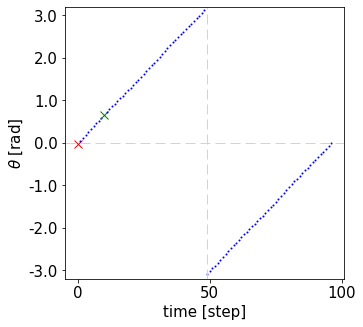

In [168]:
f, ax = plt.subplots(1, 1, figsize=(5,5))
for i in range(len(lmc_phi)):
    if i == 0:
        ax.plot(i, lmc_phi[i], 'xr', markersize = 8)
    elif i == 10:
        ax.plot(i, lmc_phi[i], 'xg', markersize = 8)
    else:
        ax.plot(i, lmc_phi[i], '.b', markersize = 2)
ax.set_xlabel('time [step]')
ax.set_ylabel(r'$\theta$ [rad]')
y1 = -4
y2 = 4
ytick = np.arange(y1, y2, 1)
ax.set_yticks(ytick)
ax.set_yticklabels(labels = ['{0:0.1f}'.format(x) for x in ytick], fontsize = 15)
plt.xticks(fontsize = 15)
ax.set_ylim([-3.2, 3.2])
ax.axhline(y = 0, linestyle = (0, (10, 5)), color = 'lightgrey', linewidth = 1)
ax.axvline(x = 49, linestyle = (0, (10, 5)), color = 'lightgrey', linewidth = 1)

pic = 'LimitCyclePhase.png'
# f.savefig(folderPath + '/Pic/' + pic, dpi = 150, facecolor = "white", bbox_inches = "tight")

External Freq = 0.5 Hz

In [5]:
# phi = 2*pi*cpgFreq
# cpgFreq *No unit need to find the conversion factor to Hz which is x10
# Ex. cpgFreq = 0.07 x 10-> 0.7 Hz x timeStep -> cycle/step

maxTime = 200
timeStep = 0.1 # working = 0.1 s/step
maxStep = maxTime/timeStep
time = np.arange(0, maxTime, timeStep)
step = np.arange(0, maxStep, 1)

cpgInitialFrequency = 0.07 # working =  0.07 
learnRate = 1.3 # Default = 1.3
alpha = 1.01
out0 = 0.2
out1 = 0.2
out2 = 0.2
cpg = plastic(out0, out1, out2, cpgInitialFrequency*2*3.14, alpha, learnRate)
cpg.getAll()

freq = 0.5 # working = 0.5
amp = 0.2
y = amp*np.sin(2*np.pi*freq*time) # freq = 0.5 cycle/s x timeStep = 0.05 cycle/step
sizeOut = time.shape[0]
out0 = np.empty((1,sizeOut))
out1 = np.empty((1,sizeOut))
out2 = np.empty((1,sizeOut))
outFreq = np.empty((1,sizeOut))
w2p = np.empty((1,sizeOut))
w02 = np.empty((1,sizeOut))
w20 = np.empty((1,sizeOut))
w00 = np.empty((1,sizeOut))
w01 = np.empty((1,sizeOut))
w10 = np.empty((1,sizeOut))
w11 = np.empty((1,sizeOut))
per = np.empty((1,sizeOut))

for idx, val in enumerate(time):
    if (val >= 10 and val < 20):
#         cpg.update(0.01)
        cpg.update(0.0)
        per[0][idx] = 0.0
    elif (val >= 20 and val < 100):
        cpg.update(amp*np.sin(2*np.pi*freq*val))
        per[0][idx] = amp*np.sin(2*np.pi*freq*val)
    elif (val >= 100):
        cpg.update(0.0)
        per[0][idx] = 0.0
    else:
        cpg.update(0.0)
        per[0][idx] = 0.0
#     print("----idx: {}".format(idx))
#     cpg.getAll()
    out0[0][idx] = cpg.getOut0()
    out1[0][idx] = cpg.getOut1()
    out2[0][idx] = cpg.getOut2()
    outFreq[0][idx] = cpg.getFrequency()
    w2p[0][idx] = cpg.getW2p()
    w02[0][idx] = cpg.getW02()
    w20[0][idx] = cpg.getW20()
    w00[0][idx] = cpg.getW00()
    w01[0][idx] = cpg.getW01()
    w10[0][idx] = cpg.getW10()
    w11[0][idx] = cpg.getW11()


NameError: name 'plastic' is not defined

External Freq = 0.5 Hz

In [ ]:
# phi = 2*pi*cpgFreq
# cpgFreq *No unit need to find the conversion factor to Hz which is x10
# Ex. cpgFreq = 0.07 x 10-> 0.7 Hz x timeStep -> cycle/step

maxTime = 200
timeStep = 0.1 # working = 0.1 s/step
maxStep = maxTime/timeStep
time = np.arange(0, maxTime, timeStep)
step = np.arange(0, maxStep, 1)

cpgInitialFrequency = 0.07
learnRate = 1.3 # Default = 1.3
alpha = 1.01
out0 = 0.2
out1 = 0.2
out2 = 0.2
cpg = plastic(out0, out1, out2, cpgInitialFrequency*2*3.14, alpha, learnRate)
cpg.getAll()

freq = 0.5 # working = 0.5
amp = 0.2
y = amp*np.sin(2*np.pi*freq*time) # freq = 0.5 cycle/s x timeStep = 0.05 cycle/step
sizeOut = time.shape[0]
out0 = np.empty((1,sizeOut))
out1 = np.empty((1,sizeOut))
out2 = np.empty((1,sizeOut))
outFreq = np.empty((1,sizeOut))
w2p = np.empty((1,sizeOut))
w02 = np.empty((1,sizeOut))
w20 = np.empty((1,sizeOut))
w00 = np.empty((1,sizeOut))
w01 = np.empty((1,sizeOut))
w10 = np.empty((1,sizeOut))
w11 = np.empty((1,sizeOut))
per = np.empty((1,sizeOut))

for idx, val in enumerate(time):
    if (val >= 10 and val < 20):
#         cpg.update(0.01)
        cpg.update(0.0)
        per[0][idx] = 0.0
    elif (val >= 20 and val < 100):
        cpg.update(amp*np.sin(2*np.pi*freq*val))
        per[0][idx] = amp*np.sin(2*np.pi*freq*val)
    elif (val >= 100):
        cpg.update(0.0)
        per[0][idx] = 0.0
    else:
        cpg.update(0.0)
        per[0][idx] = 0.0
#     print("----idx: {}".format(idx))
#     cpg.getAll()
    out0[0][idx] = cpg.getOut0()
    out1[0][idx] = cpg.getOut1()
    out2[0][idx] = cpg.getOut2()
    outFreq[0][idx] = cpg.getFrequency()
    w2p[0][idx] = cpg.getW2p()
    w02[0][idx] = cpg.getW02()
    w20[0][idx] = cpg.getW20()
    w00[0][idx] = cpg.getW00()
    w01[0][idx] = cpg.getW01()
    w10[0][idx] = cpg.getW10()
    w11[0][idx] = cpg.getW11()


out0_t: 0.2
out1_t: 0.2
out2_t: 0.2
freq: 0.07
alpha: 1.01
w20_t: 0
w02_t: 1
w2p_t: 0.03
learning: 1.3
A02: 1
A20: 1
A2p: 1
B02: 0.01
B20: 0.01
B2p: 0.01


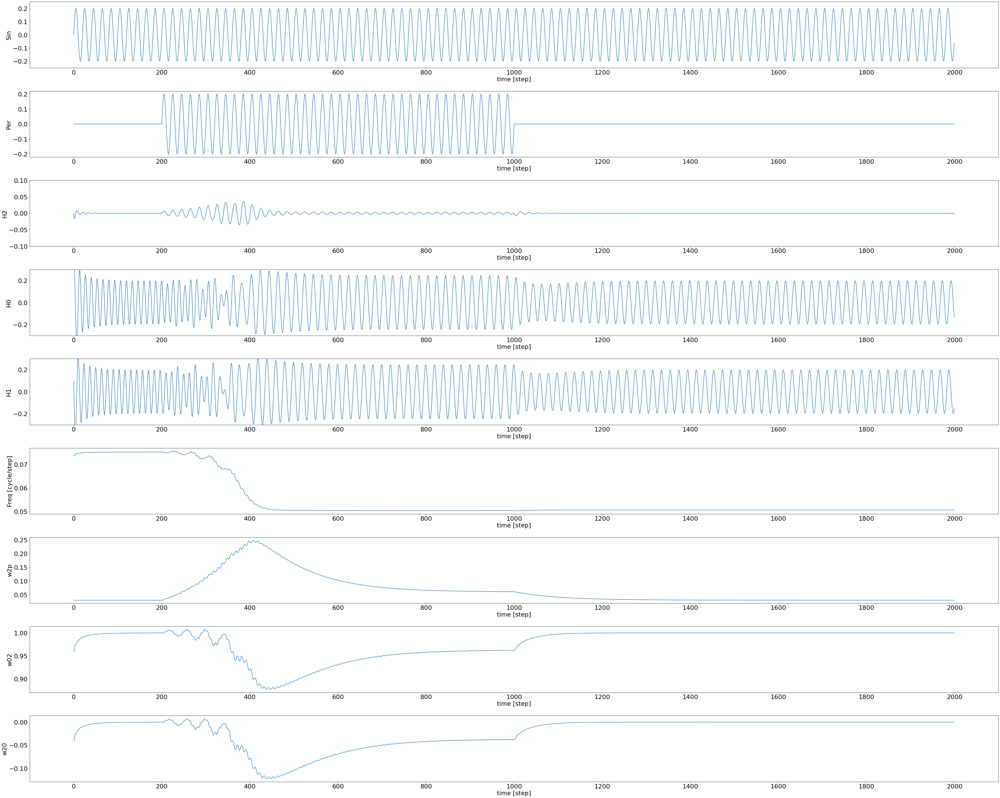

In [ ]:
plt.rcParams.update({'font.size': 22})

f = plt.figure(figsize=(50,40))
ax1 = f.add_subplot(911)
ax2 = f.add_subplot(912)
ax3 = f.add_subplot(913)
ax4 = f.add_subplot(914)
ax5 = f.add_subplot(915)
ax6 = f.add_subplot(916)
ax7 = f.add_subplot(917) # w2p
ax8 = f.add_subplot(918) # w02
ax9 = f.add_subplot(919) # w20

ax1.plot(step, y)
ax1.set_xlabel('time [step]')
ax1.set_ylabel('Sin')
ax1.set(ylim = (-0.25, 0.25))
ax1.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax2.plot(step, per[0])
ax2.set_xlabel('time [step]')
ax2.set_ylabel('Per')
# ax2.set(ylim = (-0.1, 0.1))
ax2.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax3.plot(step, out2[0])
ax3.set_xlabel('time [step]')
ax3.set_ylabel('H2')
ax3.set(ylim = (-0.1, 0.1))
ax3.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax4.plot(step, out0[0])
ax4.set_xlabel('time [step]')
ax4.set_ylabel('H0')
ax4.set(ylim = (-0.3, 0.3))
ax4.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax5.plot(step, out1[0])
ax5.set_xlabel('time [step]')
ax5.set_ylabel('H1')
ax5.set(ylim = (-0.3, 0.3))
ax5.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax6.plot(step, outFreq[0]) # 10 is conversion factor from cpgFreq to Hz
ax6.set_xlabel('time [step]')
ax6.set_ylabel('Freq [cycle/step]')
# ax6.set(ylim = (min(outFreq[0]), max(outFreq[0])))
# ax6.set_yticks(np.arange(0, 1.1, 0.1))
ax6.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax7.plot(step, w2p[0])
ax7.set_xlabel('time [step]')
ax7.set_ylabel('w2p')
# ax7.set_yticks(np.arange(0, 1.1, 0.1))
ax7.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax8.plot(step, w02[0])
ax8.set_xlabel('time [step]')
ax8.set_ylabel('w02')
# ax8.set_yticks(np.arange(0, 1.1, 0.1))
ax8.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax9.plot(step, w20[0])
ax9.set_xlabel('time [step]')
ax9.set_ylabel('w20')
# ax9.set_yticks(np.arange(0, 1.1, 0.1))
ax9.set_xticks(np.arange(0, maxStep + 1, maxStep/10))


plt.tight_layout()
plt.show()
# picCPGSim = 'CPGSim.eps'
# f.savefig(picCPGSim, dpi = 300)

Subject joint angels experiment from RUN EIEI

In [5]:
# phi = 2*pi*cpgFreq
# cpgFreq *No unit need to find the conversion factor to Hz which is x10
# Ex. cpgInitialFrequency_world = 0.07() x 10-> 0.7 Hz x timeStep -> cycle/step
# cpgInitialFrequency_world = cpgInitialFrequency(fcpg) x 1/discrete factor * Update rate_ROS
y = np.array(subject_numpy_num)
y = y[:,0]
y = y*0.005 #0.005
r = y.shape
print("y.shape", y.shape)
zeros_initial = np.zeros(10000)
y_new = np.concatenate((zeros_initial, y), axis=None)
print(y_new)
print("y_new.shape",y_new.shape)
# maxTime = c/10.0  #42.406 sec
# timeStep = 0.001 # working = 0.1 s/step
# maxStep = maxTime/timeStep
maxTime = 42.406+10.2415109
timeStep = 0.00102415109
maxStep = maxTime/timeStep
time = np.arange(0, maxTime, timeStep)
print("time.shape",time.shape)
# step = np.arange(0, maxStep, 1)
step = np.arange(0, maxStep, 1)
print("step.shape",step.shape)

# cpgInitialFrequency = 0.07 
cpgInitialFrequency = 0.01  #fcpg
learnRate = 1.3 # Default = 1.3
alpha = 1.01
out0 = 0.2
out1 = 0.2
out2 = 0.2
cpg = plastic(out0, out1, out2, cpgInitialFrequency*2*3.14, alpha, learnRate)
cpg.getAll()

# freq = 0.5 # working = 0.5
# amp = 0.2
# y = np.array(subject_numpy_num)
# print(y[1][0])
sizeOut = time.shape[0]
out0 = np.empty((1,sizeOut))
out1 = np.empty((1,sizeOut))
out2 = np.empty((1,sizeOut))
outFreq = np.empty((1,sizeOut))
w2p = np.empty((1,sizeOut))
w02 = np.empty((1,sizeOut))
w20 = np.empty((1,sizeOut))
w00 = np.empty((1,sizeOut))
w01 = np.empty((1,sizeOut))
w10 = np.empty((1,sizeOut))
w11 = np.empty((1,sizeOut))
per = np.empty((1,sizeOut))

discretizedFactor = 10  # f

# for idx, val in enumerate(time): # ในลูปอาจจะ mod 100
for idx, val in enumerate(step):
    # if (val >= 25000 and val < 35000):
    # if (val > 10000 ):
        # per[0][idx] = y[idx-10000][0]
    # per[0][idx] = y_new[idx]
    # elif (val < 10000 ):
    #     per[0][idx] = zeros_initial[idx]
    # else:
    #     per[0][idx] = 0.0
        # cpg.update(0.0)
    if (val <= 30000 ):
        per[0][idx] = y_new[idx]
    else:
        per[0][idx] = 0.0
        
    if ((val % discretizedFactor) == 0):
        # if (val >= 25000 and val < 35000):
        #     cpg.update(y[idx][0])
        # else:
        #     cpg.update(0.0)
        # if (val < 10000):
        #     cpg.update(zeros_initial[idx])
        # elif (val > 10000):
        #     cpg.update(y[idx-10000][0])
        cpg.update(y_new[idx])



#     # เป็นส่วนใส่ pertubation เฉยๆ
#     if (val >= 10 and val < 20):
# #         cpg.update(0.01)
#         cpg.update(0.0)
#         per[0][idx] = y[idx][0]
#     elif (val >= 20 and val < 100):
#         cpg.update(y[idx][0])
#         per[0][idx] = y[idx][0]
#     elif (val >= 100):
#         cpg.update(y[idx][0])
#         per[0][idx] = y[idx][0]
#     else:
#         cpg.update(y[idx][0])
#         per[0][idx] = y[idx][0]
# #     print("----idx: {}".format(idx))
# #     cpg.getAll()
    out0[0][idx] = cpg.getOut0() 
    out1[0][idx] = cpg.getOut1() 
    out2[0][idx] = cpg.getOut2() 
    outFreq[0][idx] = cpg.getFrequency() 
    w2p[0][idx] = cpg.getW2p() 
    w02[0][idx] = cpg.getW02() 
    w20[0][idx] = cpg.getW20() 
    w00[0][idx] = cpg.getW00() 
    w01[0][idx] = cpg.getW01() 
    w10[0][idx] = cpg.getW10() 
    w11[0][idx] = cpg.getW11() 


y.shape (41406,)
[ 0.     0.     0.    ... -0.055 -0.055 -0.055]
y_new.shape (51406,)
time.shape (51406,)
step.shape (51406,)
out0_t: 0.2
out1_t: 0.2
out2_t: 0.2
freq: 0.01
alpha: 1.01
w20_t: 0
w02_t: 1
w2p_t: 0.03
learning: 1.3
A02: 1
A20: 1
A2p: 1
B02: 0.01
B20: 0.01
B2p: 0.01


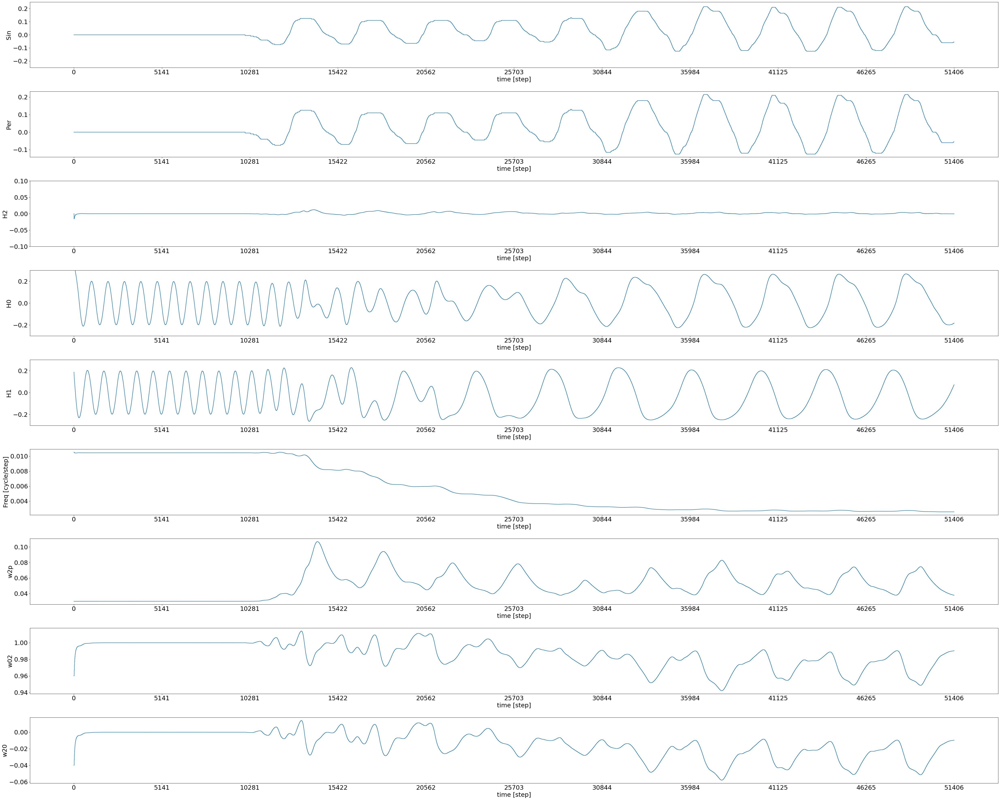

In [68]:
plt.rcParams.update({'font.size': 22})

f = plt.figure(figsize=(50,40))
ax1 = f.add_subplot(911)
ax2 = f.add_subplot(912)
ax3 = f.add_subplot(913)
ax4 = f.add_subplot(914)
ax5 = f.add_subplot(915)
ax6 = f.add_subplot(916)
ax7 = f.add_subplot(917) # w2p
ax8 = f.add_subplot(918) # w02
ax9 = f.add_subplot(919) # w20

# ax1.plot(step, y)
ax1.plot(step, y_new)
ax1.set_xlabel('time [step]')
ax1.set_ylabel('Sin')
ax1.set(ylim = (-0.25, 0.25))
ax1.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax2.plot(step, per[0])
ax2.set_xlabel('time [step]')
ax2.set_ylabel('Per')
# ax2.set(ylim = (-0.1, 0.1))
ax2.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax3.plot(step, out2[0])
ax3.set_xlabel('time [step]')
ax3.set_ylabel('H2')
ax3.set(ylim = (-0.1, 0.1))
ax3.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax4.plot(step, out0[0])
ax4.set_xlabel('time [step]')
ax4.set_ylabel('H0')
ax4.set(ylim = (-0.3, 0.3))
ax4.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax5.plot(step, out1[0])
ax5.set_xlabel('time [step]')
ax5.set_ylabel('H1')
ax5.set(ylim = (-0.3, 0.3))
ax5.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax6.plot(step, outFreq[0]) # 10 is conversion factor from cpgFreq to Hz
ax6.set_xlabel('time [step]')
ax6.set_ylabel('Freq [cycle/step]')
# ax6.set(ylim = (min(outFreq[0]), max(outFreq[0])))
# ax6.set_yticks(np.arange(0, 1.1, 0.1))
ax6.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax7.plot(step, w2p[0])
ax7.set_xlabel('time [step]')
ax7.set_ylabel('w2p')
# ax7.set_yticks(np.arange(0, 1.1, 0.1))
ax7.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax8.plot(step, w02[0])
ax8.set_xlabel('time [step]')
ax8.set_ylabel('w02')
# ax8.set_yticks(np.arange(0, 1.1, 0.1))
ax8.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax9.plot(step, w20[0])
ax9.set_xlabel('time [step]')
ax9.set_ylabel('w20')
# ax9.set_yticks(np.arange(0, 1.1, 0.1))
ax9.set_xticks(np.arange(0, maxStep + 1, maxStep/10))


plt.tight_layout()
plt.savefig("AFDC_ubject1_OAIC_S38_4-JointAngles.png") 
plt.show()
# picCPGSim = 'CPGSim.eps'
# f.savefig(picCPGSim, dpi = 300)

RUN experiment plotly version

In [6]:
from plotly import tools
import plotly.graph_objects as go
# from plotly.subplots import make_subplots

In [7]:
# Add traces
# fig = make_subplots(rows=9, cols=1, subplot_titles=("Plot 1", "Plot 2", "Plot 3"))
fig = tools.make_subplots(rows = 9, cols = 1)
# fig = go.Figure()
fig.add_trace(go.Scatter(x=step, y=per[0], mode='lines'), row=1, col=1 )
fig.add_trace(go.Scatter(x=step, y=out2[0], mode='lines'), row=2, col=1 )
fig.add_trace(go.Scatter(x=step, y=out0[0], mode='lines'), row=3, col=1 )
fig.add_trace(go.Scatter(x=step, y=out1[0], mode='lines'), row=4, col=1 )
fig.add_trace(go.Scatter(x=step, y=outFreq[0], mode='lines'), row=5, col=1 )
fig.add_trace(go.Scatter(x=step, y=w2p[0], mode='lines'), row=6, col=1 )
fig.add_trace(go.Scatter(x=step, y=w02[0], mode='lines'), row=7, col=1 )
fig.add_trace(go.Scatter(x=step, y=w20[0], mode='lines'), row=8, col=1 )

# Update xaxis properties
# fig.update_xaxes(title_text="time [step]", row=1, col=1)
# fig.update_xaxes(title_text="time [step]", row=2, col=1)
# fig.update_xaxes(title_text="time [step]", row=3, col=1)
# fig.update_xaxes(title_text="time [step]", row=4, col=1)
# fig.update_xaxes(title_text="time [step]", row=5, col=1)
# fig.update_xaxes(title_text="time [step]", row=6, col=1)
# fig.update_xaxes(title_text="time [step]", row=7, col=1)
fig.update_xaxes(title_text="time [step]", row=8, col=1)
# fig.update_xaxes(title_text="xaxis 4 title", row=4, col=1)

# # Update yaxis properties
fig.update_yaxes(title_text="Per", row=1, col=1)
fig.update_yaxes(title_text="H2", row=2, col=1)
fig.update_yaxes(title_text="H0", row=3, col=1)
fig.update_yaxes(title_text="H1", row=4, col=1)
fig.update_yaxes(title_text="Freq [cycle/step]", row=5, col=1)
fig.update_yaxes(title_text="w2p", row=6, col=1)
fig.update_yaxes(title_text="w02", row=7, col=1)
fig.update_yaxes(title_text="w20", row=8, col=1)
# fig.update_yaxes(title_text="yaxis 4 title", row=4, col=1)
# fig = tools.make_subplots(rows = 1, cols = 2, specs = [[{}, {}]],
#                           horizontal_spacing = 0.05)
fig.update_layout(height=800, width=800)
fig.show()


/home/karn/.virtualenvs/droneVision/lib/python3.10/site-packages/plotly/tools.py:455: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



External Freq = 0.5 Hz

In [ ]:
# phi = 2*pi*cpgFreq
# cpgFreq *No unit need to find the conversion factor to Hz which is x10
# Ex. cpgFreq = 0.07 x 10-> 0.7 Hz x timeStep -> cycle/step

maxTime = 200
timeStep = 0.1 # working = 0.1 s/step
maxStep = maxTime/timeStep
time = np.arange(0, maxTime, timeStep)
step = np.arange(0, maxStep, 1)

cpgInitialFrequency = 0.07 # working =  0.07 
learnRate = 1.3 # Default = 1.3
alpha = 1.01
out0 = 0.2
out1 = 0.2
out2 = 0.2
cpg = plastic(out0, out1, out2, cpgInitialFrequency*2*3.14, alpha, learnRate)
cpg.getAll()

freq = 0.5 # working = 0.5
amp = 0.2
y = amp*np.sin(2*np.pi*freq*time) # freq = 0.5 cycle/s x timeStep = 0.05 cycle/step
sizeOut = time.shape[0]
out0 = np.empty((1,sizeOut))
out1 = np.empty((1,sizeOut))
out2 = np.empty((1,sizeOut))
outFreq = np.empty((1,sizeOut))
w2p = np.empty((1,sizeOut))
w02 = np.empty((1,sizeOut))
w20 = np.empty((1,sizeOut))
w00 = np.empty((1,sizeOut))
w01 = np.empty((1,sizeOut))
w10 = np.empty((1,sizeOut))
w11 = np.empty((1,sizeOut))
per = np.empty((1,sizeOut))

for idx, val in enumerate(time):
    if (val >= 5 and val < 10):
#         cpg.update(0.01)
        cpg.update(0.0)
        per[0][idx] = 0.0
    elif (val >= 10 and val < 40):
        cpg.update(amp*np.sin(2*np.pi*freq*val))
        per[0][idx] = amp*np.sin(2*np.pi*freq*val)
    elif (val >= 40):
        cpg.update(0.0)
        per[0][idx] = 0.0
    else:
        cpg.update(0.0)
        per[0][idx] = 0.0
#     print("----idx: {}".format(idx))
#     cpg.getAll()
    out0[0][idx] = cpg.getOut0()
    out1[0][idx] = cpg.getOut1()
    out2[0][idx] = cpg.getOut2()
    outFreq[0][idx] = cpg.getFrequency()
    w2p[0][idx] = cpg.getW2p()
    w02[0][idx] = cpg.getW02()
    w20[0][idx] = cpg.getW20()
    w00[0][idx] = cpg.getW00()
    w01[0][idx] = cpg.getW01()
    w10[0][idx] = cpg.getW10()
    w11[0][idx] = cpg.getW11()

out0_t: 0.2
out1_t: 0.2
out2_t: 0.2
freq: 0.07
alpha: 1.01
w20_t: 0
w02_t: 1
w2p_t: 0.03
learning: 1.3
A02: 1
A20: 1
A2p: 1
B02: 0.01
B20: 0.01
B2p: 0.01


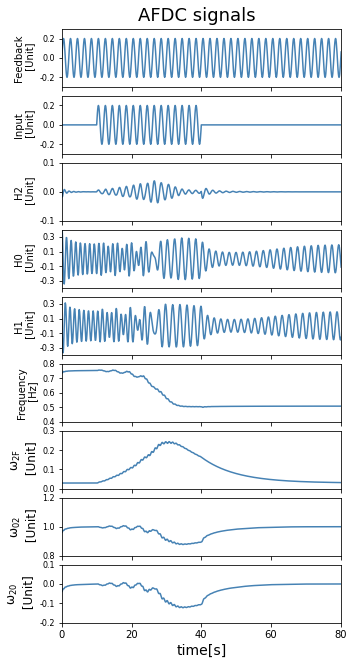

In [ ]:
# -------------------------------------------------------------------------------------------------
# Figure
# -------------------------------------------------------------------------------------------------
f = plt.figure(figsize = (5, 10)) # W x H
f.tight_layout(pad = 1)
f.subplots_adjust(top = 0.95)
f.suptitle('AFDC signals', fontsize = 18) 

# Outer ---------------------------------------
outer = gridspec.GridSpec(1, 1, figure = f, wspace = 0.15)
axOut00 = f.add_subplot(outer[0])
axOut00.tick_params(top = False, bottom = False, left = False, right = False)
axOut00.set_xticklabels([])
axOut00.set_yticklabels([])
axOut00._frameon = False
# axOut00.set_title('', fontsize = 16, pad = 40)

# Inner 1 ---------------------------------------
inner1 = gridspec.GridSpecFromSubplotSpec(9, 1, subplot_spec = outer[0], wspace = 0.12, hspace = 0.15)

# Ax ------------------------------------
feedbackAx = f.add_subplot(inner1[0])
inputAx = f.add_subplot(inner1[1], sharex = feedbackAx)
H2Ax = f.add_subplot(inner1[2], sharex = feedbackAx)
H0Ax = f.add_subplot(inner1[3], sharex = feedbackAx)
H1Ax = f.add_subplot(inner1[4], sharex = feedbackAx)
freqAx = f.add_subplot(inner1[5], sharex = feedbackAx)
w2FAx = f.add_subplot(inner1[6], sharex = feedbackAx)
w02Ax = f.add_subplot(inner1[7], sharex = feedbackAx)
w20Ax = f.add_subplot(inner1[8], sharex = feedbackAx)

# Plot ------------------------------------
# For tick and label
xticksStr = 0
xticksEnd = maxTime
xticksV = np.linspace(xticksStr, xticksEnd, num = 11, endpoint = True)
xticksLabelV = ["{0:d}".format(int(x)) for x in np.linspace(xticksStr, xticksEnd, num = 11, endpoint = True)]
# print(xticksV)
# print(xticksLabelV)

xSelStart = 0
xSelEnd = 80

strPt1 = 0
endPt1 = len(y) - 1
yBot = -0.4
yTop = 0.4
g_Feedback, = feedbackAx.plot(time[strPt1:endPt1], y[strPt1:endPt1], '-', color = 'steelblue', markersize = 0.1)
feedbackAx.set_xticks(ticks = xticksV)
feedbackAx.tick_params(axis = 'x', labelbottom = False)
feedbackAx.set_ylabel('Feedback\n [Unit]', fontsize = 10)
feedbackAx.set_yticks(ticks = np.arange(yBot, yTop, step = 0.2))
feedbackAx.set_yticklabels(labels = ["{0:.1f}".format(x) for x in np.arange(yBot, yTop, step = 0.2)], fontsize = 8)
# feedbackAx.set_title('', fontsize = 14, pad = 10)
# feedbackAx.grid(alpha = 0.4)
feedbackAx.set_xlim(left = xSelStart, right = xSelEnd)
feedbackAx.set_ylim(bottom = -0.3, top = 0.3)


yBot = -0.4
yTop = 0.4
g_Input, = inputAx.plot(time[strPt1:endPt1], per[0][strPt1:endPt1], '-', color = 'steelblue', markersize = 0.1)
inputAx.set_xticks(ticks = xticksV)
inputAx.tick_params(axis = 'x', labelbottom = False)
inputAx.set_ylabel('Input\n [Unit]', fontsize = 10)
inputAx.set_yticks(ticks = np.arange(yBot, yTop, step = 0.2))
inputAx.set_yticklabels(labels = ["{0:.1f}".format(x) for x in np.arange(yBot, yTop, step = 0.2)], fontsize = 8)
# inputAx.set_title('', fontsize = 14, pad = 10)
# inputAx.grid(alpha = 0.4)
inputAx.set_xlim(left = xSelStart, right = xSelEnd)
inputAx.set_ylim(bottom = -0.3, top = 0.3)


yBot = -0.2
yTop = 0.2
g_H2, = H2Ax.plot(time[strPt1:endPt1], out2[0][strPt1:endPt1], '-', color = 'steelblue', markersize = 0.1)
H2Ax.set_xticks(ticks = xticksV)
H2Ax.tick_params(axis = 'x', labelbottom = False)
H2Ax.set_ylabel('H2\n [Unit]', fontsize = 10)
H2Ax.set_yticks(ticks = np.arange(yBot, yTop, step = 0.1))
H2Ax.set_yticklabels(labels = ["{0:.1f}".format(x) for x in np.arange(yBot, yTop, step = 0.1)], fontsize = 8)
# H2Ax.set_title('', fontsize = 14, pad = 10)
# H2Ax.grid(alpha = 0.4)
H2Ax.set_xlim(left = xSelStart, right = xSelEnd)
H2Ax.set_ylim(bottom = -0.1, top = 0.1)


yBot = -0.5
yTop = 0.5
g_H0, = H0Ax.plot(time[strPt1:endPt1], out0[0][strPt1:endPt1], '-', color = 'steelblue', markersize = 0.1)
H0Ax.set_xticks(ticks = xticksV)
H0Ax.tick_params(axis = 'x', labelbottom = False)
H0Ax.set_ylabel('H0\n [Unit]', fontsize = 10)
H0Ax.set_yticks(ticks = np.arange(yBot, yTop, step = 0.2))
H0Ax.set_yticklabels(labels = ["{0:.1f}".format(x) for x in np.arange(yBot, yTop, step = 0.2)], fontsize = 8)
# H0Ax.set_title('', fontsize = 14, pad = 10)
# H0Ax.grid(alpha = 0.4)
H0Ax.set_xlim(left = xSelStart, right = xSelEnd)
H0Ax.set_ylim(bottom = -0.4, top = 0.4)


yBot = -0.5
yTop = 0.5
g_H1, = H1Ax.plot(time[strPt1:endPt1], out1[0][strPt1:endPt1], '-', color = 'steelblue', markersize = 0.1)
H1Ax.set_xticks(ticks = xticksV)
H1Ax.tick_params(axis = 'x', labelbottom = False)
H1Ax.set_ylabel('H1\n [Unit]', fontsize = 10)
H1Ax.set_yticks(ticks = np.arange(yBot, yTop, step = 0.2))
H1Ax.set_yticklabels(labels = ["{0:.1f}".format(x) for x in np.arange(yBot, yTop, step = 0.2)], fontsize = 8)
# H1Ax.set_title('', fontsize = 14, pad = 10)
# H1Ax.grid(alpha = 0.4)
H1Ax.set_xlim(left = xSelStart, right = xSelEnd)
H1Ax.set_ylim(bottom = -0.4, top = 0.4)


yBot = 0
yTop = 1.5
g_Freq, = freqAx.plot(time[strPt1:endPt1], outFreq[0][strPt1:endPt1]*10, '-', color = 'steelblue', markersize = 0.1)
freqAx.set_xticks(ticks = xticksV)
freqAx.tick_params(axis = 'x', labelbottom = False)
freqAx.set_ylabel('Frequency\n [Hz]', fontsize = 10)
freqAx.set_yticks(ticks = np.arange(yBot, yTop, step = 0.1))
freqAx.set_yticklabels(labels = ["{0:.1f}".format(x) for x in np.arange(yBot, yTop, step = 0.1)], fontsize = 8)
# freqAx.set_title('', fontsize = 14, pad = 10)
# freqAx.grid(alpha = 0.4)
freqAx.set_xlim(left = xSelStart, right = xSelEnd)
freqAx.set_ylim(bottom = 0.4, top = 0.8)


yBot = 0
yTop = 0.4
g_w2F, = w2FAx.plot(time[strPt1:endPt1], w2p[0][strPt1:endPt1], '-', color = 'steelblue', markersize = 0.1)
w2FAx.set_xticks(ticks = xticksV)
w2FAx.tick_params(axis = 'x', labelbottom = False)
w2FAx.set_ylabel('$\mathrm{\omega_{2F}}$\n [Unit]', fontsize = 12)
w2FAx.set_yticks(ticks = np.arange(yBot, yTop, step = 0.1))
w2FAx.set_yticklabels(labels = ["{0:.1f}".format(x) for x in np.arange(yBot, yTop, step = 0.1)], fontsize = 8)
# w2FAx.set_title('', fontsize = 14, pad = 10)
# w2FAx.grid(alpha = 0.4)
w2FAx.set_xlim(left = xSelStart, right = xSelEnd)
w2FAx.set_ylim(bottom = 0, top = 0.3)


yBot = 0
yTop = 1.4
g_w02, = w02Ax.plot(time[strPt1:endPt1], w02[0][strPt1:endPt1], '-', color = 'steelblue', markersize = 0.1)
w02Ax.set_xticks(ticks = xticksV)
w02Ax.tick_params(axis = 'x', labelbottom = False)
w02Ax.set_ylabel('$\mathrm{\omega_{02}}$\n [Unit]', fontsize = 12)
w02Ax.set_yticks(ticks = np.arange(yBot, yTop, step = 0.2))
w02Ax.set_yticklabels(labels = ["{0:.1f}".format(x) for x in np.arange(yBot, yTop, step = 0.2)], fontsize = 8)
# w02Ax.set_title('', fontsize = 14, pad = 10)
# w02Ax.grid(alpha = 0.4)
w02Ax.set_xlim(left = xSelStart, right = xSelEnd)
w02Ax.set_ylim(bottom = 0.8, top = 1.2)


yBot = -0.2
yTop = 0.1
g_w20, = w20Ax.plot(time[strPt1:endPt1], w20[0][strPt1:endPt1], '-', color = 'steelblue', markersize = 0.1)
w20Ax.set_xticks(ticks = xticksV)
# w20Ax.tick_params(axis = 'x', labelbottom = False)
w20Ax.set_xticklabels(labels = xticksLabelV, fontsize = 10, rotation = '0')
w20Ax.set_xlabel('time[s]', fontsize = 14)
w20Ax.set_ylabel('$\mathrm{\omega_{20}}$\n [Unit]', fontsize = 12)
w20Ax.set_yticks(ticks = np.arange(yBot, yTop, step = 0.1))
w20Ax.set_yticklabels(labels = ["{0:.1f}".format(x) for x in np.arange(yBot, yTop, step = 0.1)], fontsize = 8)
# w20Ax.set_title('', fontsize = 14, pad = 10)
# w20Ax.grid(alpha = 0.4)
w20Ax.set_xlim(left = xSelStart, right = xSelEnd)
w20Ax.set_ylim(bottom = -0.2, top = 0.1)

# -------------------
# Save
# -------------------
picAFDCSignal = folderPath + '/Pic/' + 'AFDCSignal.png'
# f.savefig(picAFDCSignal, dpi = 150, bbox_inches = 'tight', facecolor = 'w')

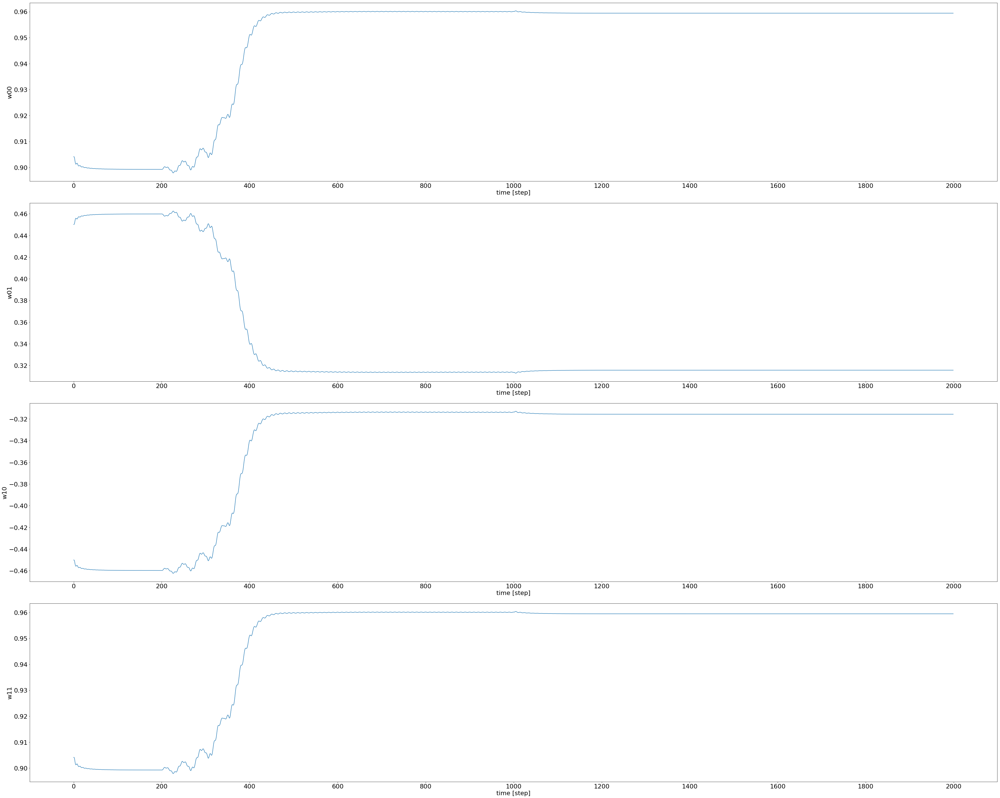

In [ ]:
plt.rcParams.update({'font.size': 22})

f = plt.figure(figsize=(50,40))
ax1 = f.add_subplot(411) # w00
ax2 = f.add_subplot(412) # w01
ax3 = f.add_subplot(413) # w10
ax4 = f.add_subplot(414) # w11

ax1.plot(step, w00[0])
ax1.set_xlabel('time [step]')
ax1.set_ylabel('w00')
# ax1.set_yticks(np.arange(0, 1.1, 0.1))
ax1.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax2.plot(step, w01[0])
ax2.set_xlabel('time [step]')
ax2.set_ylabel('w01')
# ax2.set_yticks(np.arange(0, 1.1, 0.1))
ax2.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax3.plot(step, w10[0])
ax3.set_xlabel('time [step]')
ax3.set_ylabel('w10')
# ax3.set_yticks(np.arange(0, 1.1, 0.1))
ax3.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

ax4.plot(step, w11[0])
ax4.set_xlabel('time [step]')
ax4.set_ylabel('w11')
# ax4.set_yticks(np.arange(0, 1.1, 0.1))
ax4.set_xticks(np.arange(0, maxStep + 1, maxStep/10))

plt.tight_layout()
plt.show()
# picCPGSim = 'CPGSim.eps'
# f.savefig(picCPGSim, dpi = 300)

In [ ]:
coords = list(zip(out2[0], out0[0]))
len(coords)
dList = [coords[0], coords[len(coords)-1]]
dList

[(0.0, 0.04030461111110256), (1.5e-323, -0.13319849177221024)]

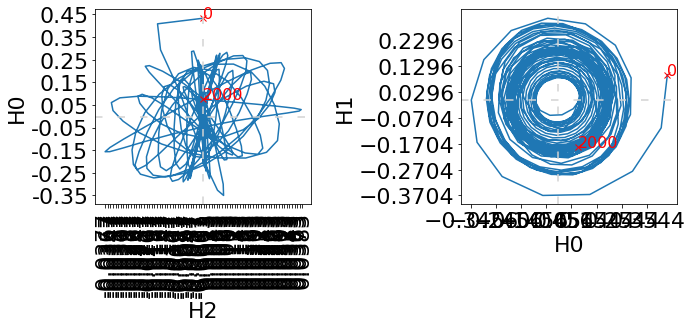

In [ ]:
f = plt.figure(figsize=(10,5))
ax1 = f.add_subplot(121) # H2, H0
ax2 = f.add_subplot(122) # H0, H1

markers_on = [0, time.shape[0]-1]
ax1.plot(out2[0], out0[0])
ax1.plot(out2[0], out0[0], 'xr', markevery = markers_on)
iList1 = 0
coords1 = list(zip(out2[0], out0[0]))
dList1 = [coords1[0], coords1[len(coords1)-1]]
for d in dList1:
    ax1.annotate('%s' %iList1, xy = d, textcoords = 'data', size = 16, color = 'r')
    
    iList1 = iList1 + len(coords1)

ax1.axvline(x = 0.0, color = 'lightgrey', linestyle = (0, (5, 10)))
ax1.axhline(y = 0.0, color = 'lightgrey', linestyle = (0, (5, 10)))
ax1.set_xlabel('H2')
ax1.set_ylabel('H0')
xlabels = np.arange(min(out2[0]), max(out2[0])+0.001, 0.001)
ax1.set_xticks(xlabels)
ax1.set_xticklabels(xlabels, rotation = 90)
ax1.xaxis.set_major_formatter(FormatStrFormatter('%.4f'))
ax1.set_yticks(np.arange(min(out0[0]), max(out0[0])+0.1, 0.1))
ax1.yaxis.set_major_formatter(FormatStrFormatter('%.2f'))

ax2.plot(out0[0], out1[0])
ax2.plot(out0[0], out1[0], 'xr', markevery = markers_on)
iList2 = 0
coords2 = list(zip(out0[0], out1[0]))
dList2 = [coords2[0], coords2[len(coords2)-1]]
for d in dList2:
    ax2.annotate('%s' %iList2, xy = d, textcoords = 'data', size = 16, color = 'r')
    iList2 = iList2 + len(coords2)
ax2.axvline(x = 0.0, color = 'lightgrey', linestyle = (0, (5, 10)))
ax2.axhline(y = 0.0, color = 'lightgrey', linestyle = (0, (5, 10)))
ax2.set_xlabel('H0')
ax2.set_ylabel('H1')
ax2.set_xticks(np.arange(min(out0[0]), max(out0[0]), 0.1))
ax2.set_yticks(np.arange(min(out1[0]), max(out1[0]), 0.1))

plt.tight_layout()
plt.show()